In [1]:
# Import library utama
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import shutil
from PIL import Image

# Library untuk preprocessing data
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Library untuk membangun model CNN
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, GlobalAveragePooling2D
from tensorflow.keras.applications import VGG16, InceptionV3, DenseNet121
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.utils import load_img, img_to_array

# Library untuk evaluasi model
from sklearn.metrics import classification_report, confusion_matrix

# Visualisasi
import matplotlib.pyplot as plt
import seaborn as sns


In [2]:
# Path ke folder dataset utama
dataset_path = Path(r"D:\KULIAH\asalamualaikum\daun_cabai_full")
classes = os.listdir(dataset_path)

In [3]:
# Folder output untuk train, validation, test
output_path = Path(r"D:\KULIAH\asalamualaikum\dataset_split")
train_path = output_path / "train"
val_path = output_path / "validation"
test_path = output_path / "test"

# Buat folder train, validation, test jika belum ada
for folder in [train_path, val_path, test_path]:
    folder.mkdir(parents=True, exist_ok=True)

# Membaca semua gambar dan label dari folder
data = []
labels = []

for class_dir in os.listdir(dataset_path):
    class_folder = dataset_path / class_dir
    if class_folder.is_dir():
        for img_file in os.listdir(class_folder):
            img_path = class_folder / img_file
            data.append(img_path)
            labels.append(class_dir)

# Membagi data menjadi train, test, validation
train_data, test_data, train_labels, test_labels = train_test_split(
    data, labels, test_size=0.3, stratify=labels, random_state=42
)

train_data, val_data, train_labels, val_labels = train_test_split(
    train_data, train_labels, test_size=0.2, stratify=train_labels, random_state=42
)

# Fungsi untuk menyalin file ke folder split
def copy_files(data, labels, output_folder):
    for img_path, label in zip(data, labels):
        label_folder = output_folder / label
        label_folder.mkdir(exist_ok=True)
        shutil.copy(img_path, label_folder / img_path.name)

# Salin file ke folder train, validation, test
copy_files(train_data, train_labels, train_path)
copy_files(val_data, val_labels, val_path)
copy_files(test_data, test_labels, test_path)

print("Data telah berhasil dibagi:")
print(f"Train: {len(train_data)}, Validation: {len(val_data)}, Test: {len(test_data)}")

Data telah berhasil dibagi:
Train: 224, Validation: 56, Test: 120


In [4]:
# Parameter untuk preprocessing
image_height, image_width = 224, 224  # Ukuran gambar untuk model VGG-16
batch_size = 32  # Ukuran batch

In [86]:

# Data Augmentation untuk dataset training
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,  # Normalisasi gambar
    rotation_range=30,  # Rotasi gambar
    width_shift_range=0.2,  # Pergeseran horizontal
    height_shift_range=0.2,  # Pergeseran vertikal
    shear_range=0.2,  # Distorsi bentuk
    zoom_range=0.2,  # Zoom in/out
    horizontal_flip=True,  # Flip horizontal
    fill_mode="nearest"  # Cara mengisi pixel kosong
)
print('Augmentasi data untuk training selesai dibuat')

# Preprocessing untuk dataset validation dan testing (tidak menggunakan augmentasi data)
test_datagen = ImageDataGenerator(rescale=1.0 / 255)
print('Rescaling untuk tresting selesai dibuat')

# Preprocessing untuk dataset validation dan testing (tidak menggunakan augmentasi data)
val_datagen = ImageDataGenerator(rescale=1.0 / 255)
print('Rescaling untuk validation selesai dibuat')

Augmentasi data untuk training selesai dibuat
Rescaling untuk tresting selesai dibuat
Rescaling untuk validation selesai dibuat


In [87]:
# Load data training dari folder yang telah dibuat
train_generator1 = train_datagen.flow_from_directory(
    "D:/KULIAH/asalamualaikum/dataset_split/train",
    target_size=(image_height, image_width),
    batch_size=batch_size,
    class_mode="categorical"
)
print('Training data berhasil dibuat\n')

Found 224 images belonging to 4 classes.
Training data berhasil dibuat



In [88]:
# Load data Validation dari folder yang telah dibuat
validation_generator1 = val_datagen.flow_from_directory(
    "D:/KULIAH/asalamualaikum/dataset_split/validation",
    target_size=(image_height, image_width),
    batch_size=batch_size,
    class_mode="categorical"
)
print('Validation data berhasil dibuat\n')

Found 56 images belonging to 4 classes.
Validation data berhasil dibuat



In [89]:
# Load data testing dari folder yang telah dibuat
test_generator1 = test_datagen.flow_from_directory(
    "D:/KULIAH/asalamualaikum/dataset_split/test",
    target_size=(image_height, image_width),
    batch_size=batch_size,
    class_mode="categorical",
    shuffle=False  # Tidak di-shuffle karna untuk evaluasi akurasi
)
print('Testing data berhasil dibuat\n')

Found 120 images belonging to 4 classes.
Testing data berhasil dibuat



In [90]:
# Menampilkan label kelas
class_names = list(train_generator1.class_indices.keys())
print(f"Class labels: {train_generator1.class_indices}")

Class labels: {'daun_bercak': 0, 'daun_gemini': 1, 'daun_layu': 2, 'daun_sehat': 3}


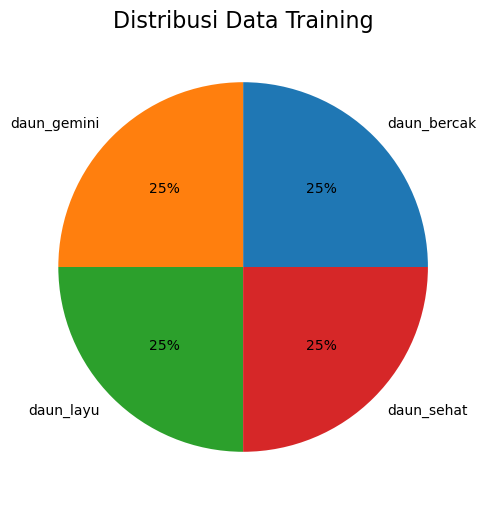

In [13]:
# Visualisasi distribusi data
frequency = np.unique(train_generator1.classes, return_counts=True)

plt.figure(figsize=(8, 6))
plt.pie(frequency[1], labels = class_names, autopct='%1.0f%%');
plt.title("Distribusi Data Training", fontsize=16)
plt.xticks(rotation=45)
plt.show()

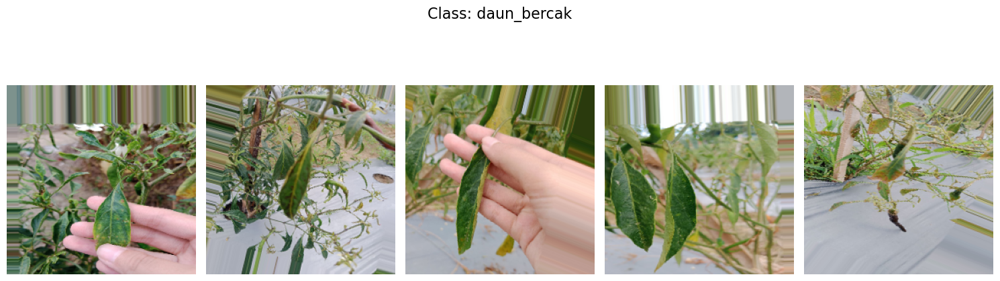

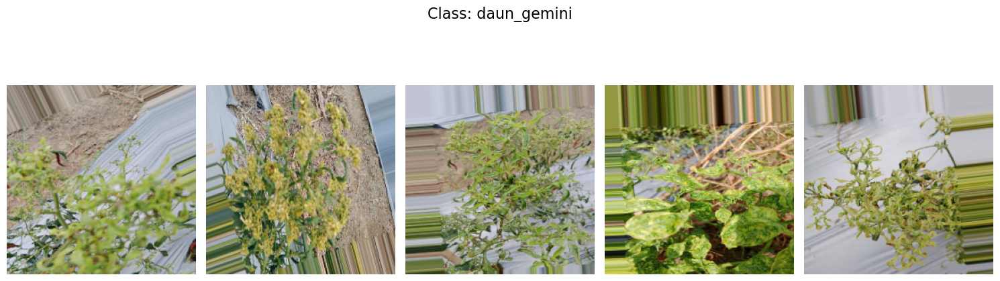

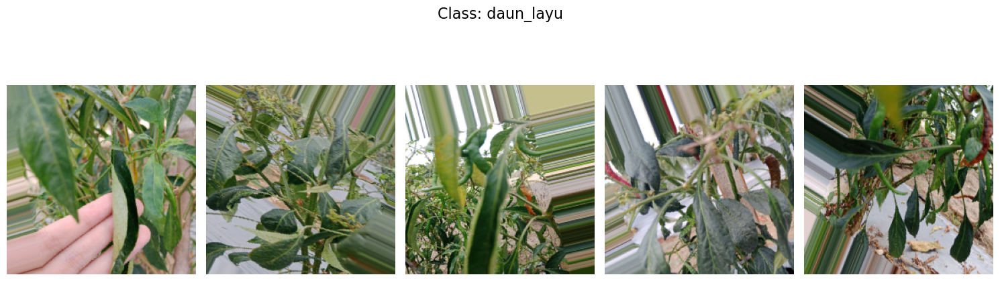

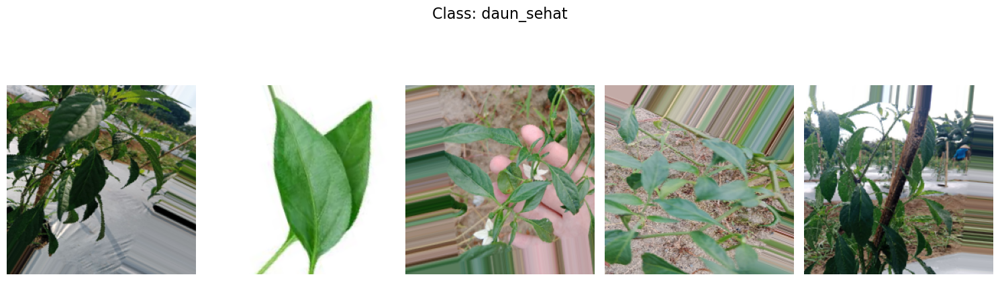

In [15]:
#Menampilkan gambar perlabel
# Fungsi untuk menampilkan 5 gambar per kelas
def display_images_by_class(data_generator, class_names, num_images=5):
    # Dictionary untuk menyimpan gambar berdasarkan label kelas
    images_by_class = {class_name: [] for class_name in class_names}

    # Iterasi untuk mengumpulkan gambar dari batch
    for _ in range(len(data_generator)):
        images, labels = next(data_generator)  # Mengambil batch dari generator
        for img, label in zip(images, labels):
            class_index = np.argmax(label)  # Menentukan kelas dari label
            class_name = class_names[class_index]
            if len(images_by_class[class_name]) < num_images:
                images_by_class[class_name].append(img)

        # Jika sudah cukup gambar untuk setiap kelas, keluar dari loop
        if all(len(images_by_class[class_name]) >= num_images for class_name in class_names):
            break

    # Visualisasi gambar
    for class_name in class_names:
        plt.figure(figsize=(15, 5))
        plt.suptitle(f"Class: {class_name}", fontsize=16)
        for i, img in enumerate(images_by_class[class_name]):
            plt.subplot(1, num_images, i + 1)
            plt.imshow(img)
            plt.axis('off')
        plt.tight_layout()
        plt.show()

# Memanggil fungsi untuk menampilkan gambar
display_images_by_class(train_generator1, class_names)


In [91]:
# Model VGG_16
# Load model VGG-16 dengan bobot dari ImageNet tanpa fully connected layers
base_model_vgg = VGG16(weights='imagenet', include_top=False, input_shape=(image_height, image_width, 3)) #shape untuk VGG-16

# Membekukan layer convolutional bawaan
for layer in base_model_vgg.layers:
    layer.trainable = False

# Menambahkan layer kustom
model_vgg = Sequential([
    base_model_vgg,
    Flatten(),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(len(class_names), activation='softmax')  # Output sesuai jumlah kelas
])

# Kompilasi model
model_vgg.compile(optimizer=Adam(learning_rate=0.0001),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

# Ringkasan model
model_vgg.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten_2 (Flatten)         (None, 25088)             0         
                                                                 
 dense_15 (Dense)            (None, 256)               6422784   
                                                                 
 dropout_9 (Dropout)         (None, 256)               0         
                                                                 
 dense_16 (Dense)            (None, 4)                 1028      
                                                                 
Total params: 21,138,500
Trainable params: 6,423,812
Non-trainable params: 14,714,688
_________________________________________________________________


In [92]:
# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

# Training VGG-16
history_vgg16 = model_vgg.fit(
    train_generator1,
    validation_data=validation_generator1,
    epochs=20,
    steps_per_epoch=train_generator1.samples // batch_size,
    validation_steps=validation_generator1.samples // batch_size,
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

Epoch 1/20
7/7 [==============================] - 112s 17s/step - loss: 1.5280 - accuracy: 0.4018 - val_loss: 1.2608 - val_accuracy: 0.4688 - lr: 1.0000e-04
Epoch 2/20
7/7 [==============================] - 114s 16s/step - loss: 1.2901 - accuracy: 0.4062 - val_loss: 1.0274 - val_accuracy: 0.5000 - lr: 1.0000e-04
Epoch 3/20
7/7 [==============================] - 113s 16s/step - loss: 1.0602 - accuracy: 0.5446 - val_loss: 1.0404 - val_accuracy: 0.5938 - lr: 1.0000e-04
Epoch 4/20
7/7 [==============================] - 114s 16s/step - loss: 0.9909 - accuracy: 0.5446 - val_loss: 0.7884 - val_accuracy: 0.6875 - lr: 1.0000e-04
Epoch 5/20
7/7 [==============================] - 114s 16s/step - loss: 0.8803 - accuracy: 0.6473 - val_loss: 0.8368 - val_accuracy: 0.6875 - lr: 1.0000e-04
Epoch 6/20
7/7 [==============================] - 112s 16s/step - loss: 0.8092 - accuracy: 0.6339 - val_loss: 0.8443 - val_accuracy: 0.6875 - lr: 1.0000e-04
Epoch 7/20
7/7 [==============================] - 115s 16s

In [94]:
# Evaluasi hasil
loss_vgg16, acc_vgg16 = model_vgg.evaluate(test_generator1)
print(f"VGG-16 Accuracy: {acc_vgg16}")

4/4 [==============================] - 50s 11s/step - loss: 0.6312 - accuracy: 0.8167
VGG-16 Accuracy: 0.8166666626930237


In [101]:
# Buka layer terakhir dari base model untuk fine-tuning
for layer in model_vgg.layers[-4:]:  # Misalnya, buka 4 layer terakhir
    layer.trainable = True

# Compile ulang model dengan learning rate lebih kecil
from tensorflow.keras.optimizers import Adam

model_vgg.compile(optimizer=Adam(learning_rate=1e-4), loss='categorical_crossentropy', metrics=['accuracy'])

# Fine-tuning
history_finevgg16 = model_vgg.fit(train_generator1, epochs=20, validation_data=validation_generator1)


Epoch 1/20
7/7 [==============================] - 127s 18s/step - loss: 0.6769 - accuracy: 0.7366 - val_loss: 0.6323 - val_accuracy: 0.8393
Epoch 2/20
7/7 [==============================] - 120s 17s/step - loss: 0.5788 - accuracy: 0.7634 - val_loss: 0.5921 - val_accuracy: 0.7857
Epoch 3/20
7/7 [==============================] - 121s 17s/step - loss: 0.5693 - accuracy: 0.7902 - val_loss: 0.6106 - val_accuracy: 0.8393
Epoch 4/20
7/7 [==============================] - 121s 17s/step - loss: 0.4976 - accuracy: 0.8170 - val_loss: 0.5663 - val_accuracy: 0.8036
Epoch 5/20
7/7 [==============================] - 121s 17s/step - loss: 0.5135 - accuracy: 0.8125 - val_loss: 0.5210 - val_accuracy: 0.8214
Epoch 6/20
7/7 [==============================] - 122s 18s/step - loss: 0.4517 - accuracy: 0.8616 - val_loss: 0.5206 - val_accuracy: 0.8214
Epoch 7/20
7/7 [==============================] - 118s 17s/step - loss: 0.4852 - accuracy: 0.8036 - val_loss: 0.4922 - val_accuracy: 0.8393
Epoch 8/20
7/7 [====

In [102]:
# Evaluasi hasil
loss_finevgg16, acc_finevgg16 = model_vgg.evaluate(test_generator1)
print(f"VGG-16 Accuracy: {acc_finevgg16}")

4/4 [==============================] - 20s 4s/step - loss: 0.4745 - accuracy: 0.7750
VGG-16 Accuracy: 0.7749999761581421


In [103]:
model_vgg.save("model_vgg.h5")
print("Model berhasil disimpan")

Model berhasil disimpan


4/4 [==============================] - 20s 5s/step - loss: 0.4745 - accuracy: 0.7750
Test VGG-16 Loss: 0.4745, Test VGG-16 Accuracy: 0.7750


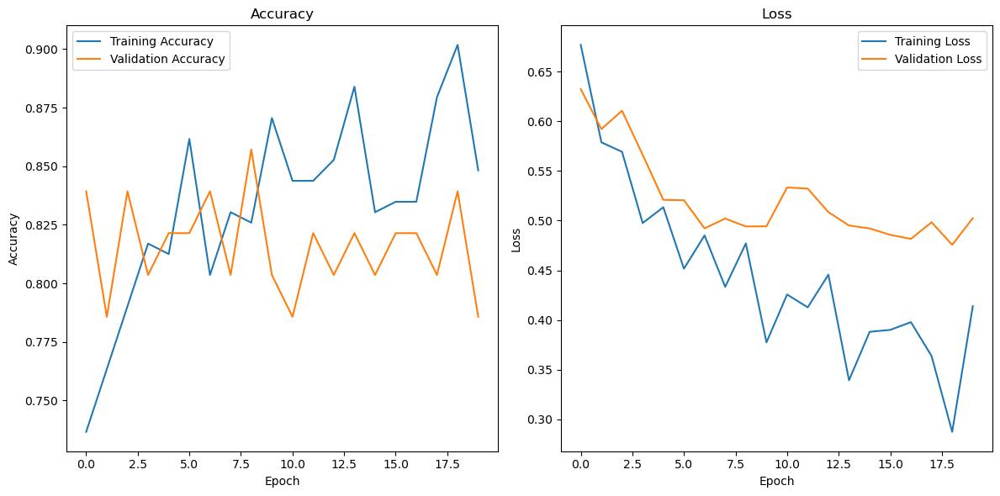

In [104]:
# Grafik plot
# Evaluasi pada test data
test_loss_vgg, test_acc_vgg = model_vgg.evaluate(test_generator1)
print(f"Test VGG-16 Loss: {test_loss_vgg:.4f}, Test VGG-16 Accuracy: {test_acc_vgg:.4f}")

# Plot grafik akurasi dan loss
plt.figure(figsize=(12, 6))

# Plot Akurasi
plt.subplot(1, 2, 1)
plt.plot(history_finevgg16.history['accuracy'], label='Training Accuracy')
plt.plot(history_finevgg16.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(history_finevgg16.history['loss'], label='Training Loss')
plt.plot(history_finevgg16.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


4/4 [==============================] - 20s 5s/step


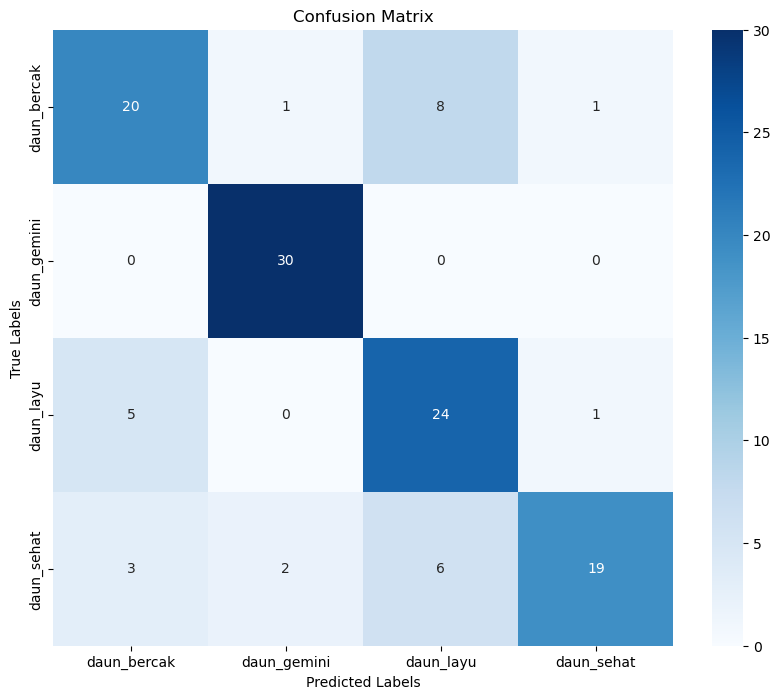

Classification Report:
              precision    recall  f1-score   support

 daun_bercak       0.71      0.67      0.69        30
 daun_gemini       0.91      1.00      0.95        30
   daun_layu       0.63      0.80      0.71        30
  daun_sehat       0.90      0.63      0.75        30

    accuracy                           0.78       120
   macro avg       0.79      0.78      0.77       120
weighted avg       0.79      0.78      0.77       120



In [105]:
# Langkah 1: Prediksi pada Test Data
Y_pred = model_vgg.predict(test_generator1)
y_pred_classes = np.argmax(Y_pred, axis=1)  # Konversi prediksi ke label kelas
y_true = test_generator1.classes  # Label sebenarnya

# Langkah 2: Confusion Matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Visualisasi Confusion Matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

# Langkah 3: Classification Report
report = classification_report(y_true, y_pred_classes, target_names=class_names)
print("Classification Report:")
print(report)


1/1 [==============================] - 1s 553ms/step


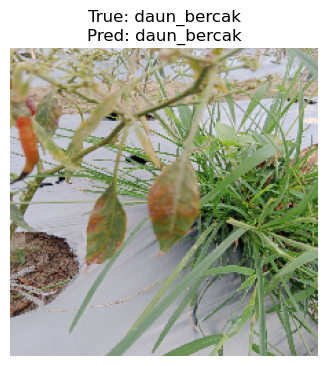

1/1 [==============================] - 0s 265ms/step


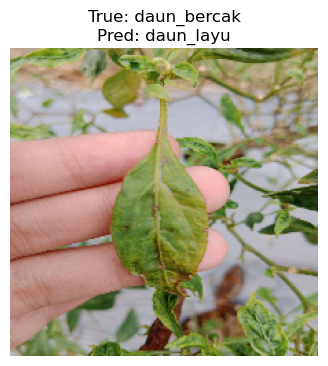

1/1 [==============================] - 0s 198ms/step


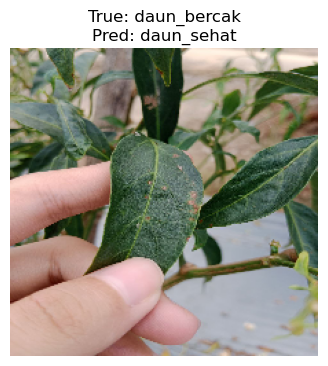

1/1 [==============================] - 0s 195ms/step


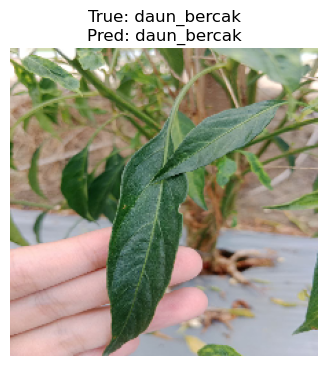

1/1 [==============================] - 0s 207ms/step


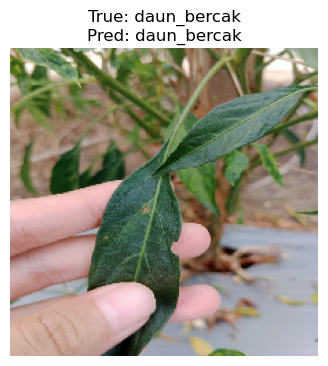

1/1 [==============================] - 0s 218ms/step


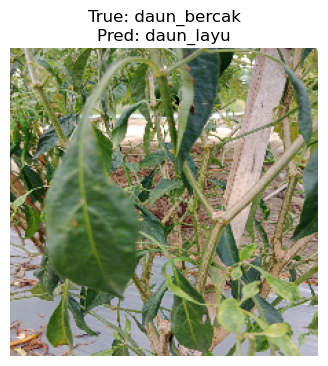

1/1 [==============================] - 0s 183ms/step


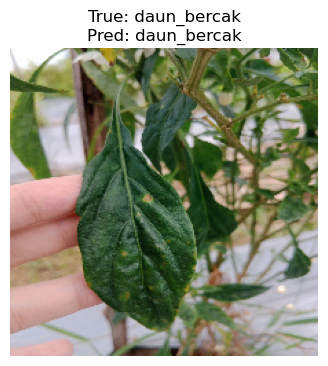

1/1 [==============================] - 0s 190ms/step


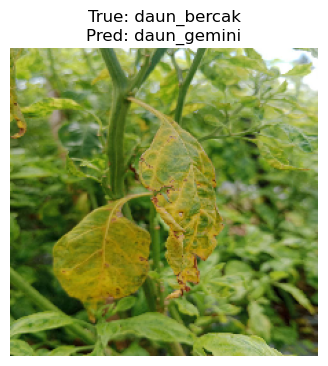

1/1 [==============================] - 0s 204ms/step


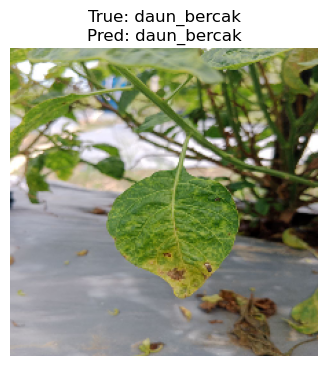

1/1 [==============================] - 0s 186ms/step


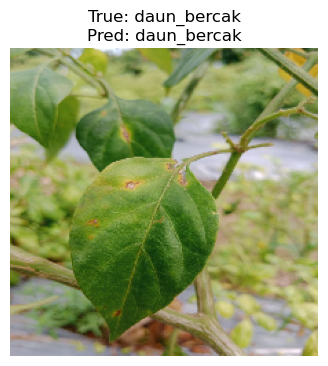

1/1 [==============================] - 0s 183ms/step


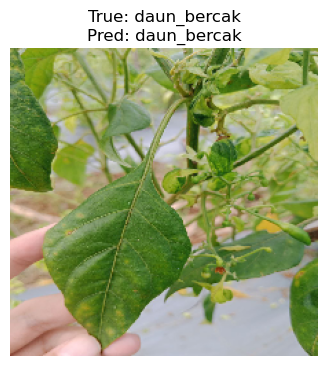

1/1 [==============================] - 0s 190ms/step


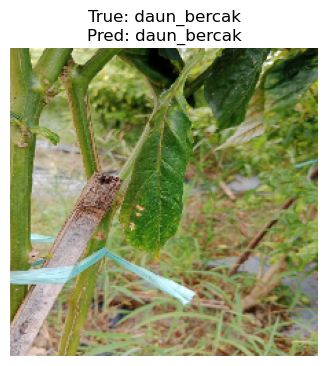

1/1 [==============================] - 0s 188ms/step


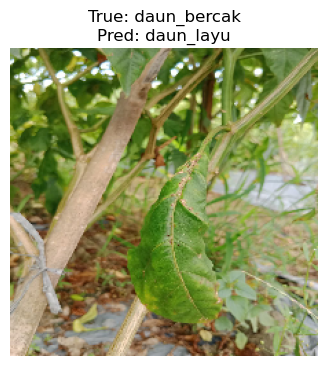

1/1 [==============================] - 0s 194ms/step


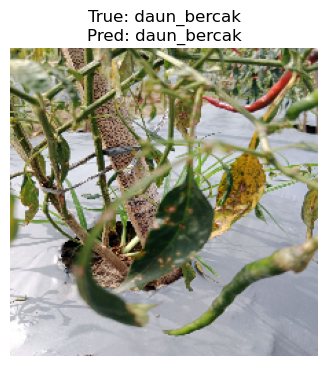

1/1 [==============================] - 0s 188ms/step


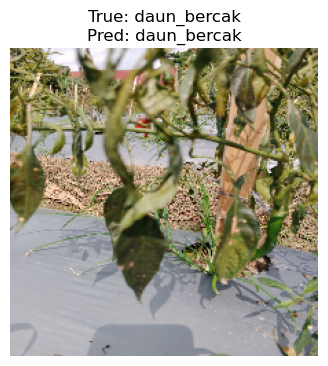

1/1 [==============================] - 0s 202ms/step


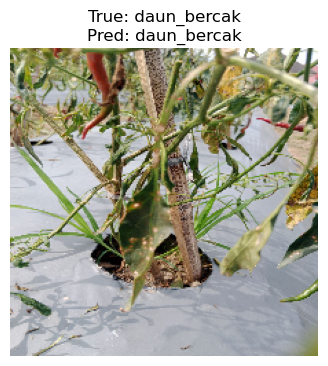

1/1 [==============================] - 0s 242ms/step


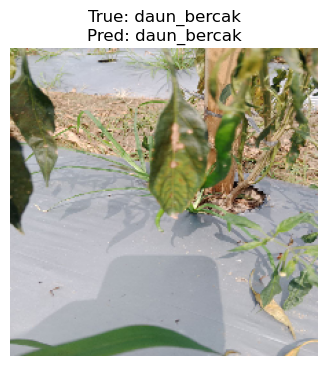

1/1 [==============================] - 0s 196ms/step


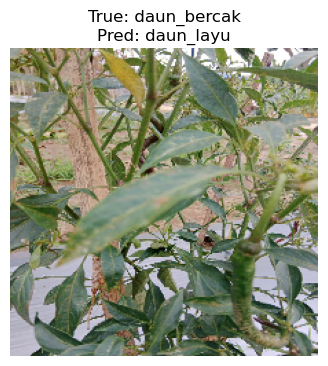

1/1 [==============================] - 0s 186ms/step


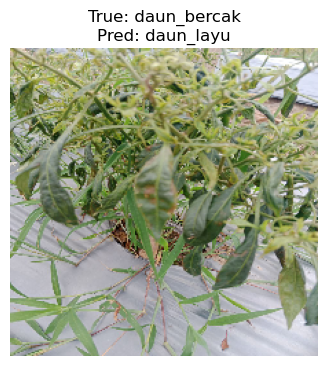

1/1 [==============================] - 0s 226ms/step


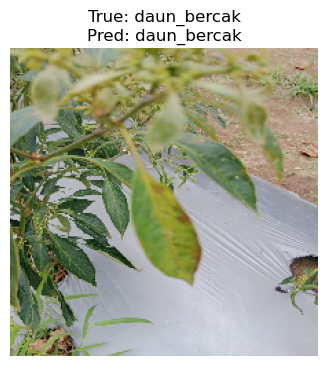

In [106]:
# Validasi prediksi pada 10 gambar pertama dari test_generator
test_images, test_labels = next(test_generator1)

for i in range(20):  # Cek 20 gambar pertama
    img = test_images[i]
    true_class_index = np.argmax(test_labels[i])
    true_class_name = class_names[true_class_index]

    # Prediksi model
    prediction = model_vgg.predict(img.reshape(1, 224, 224, 3))
    predicted_class_index = np.argmax(prediction)
    predicted_class_name = class_names[predicted_class_index]

    # Visualisasi
    plt.figure(figsize=(4, 4))
    plt.imshow(img)
    plt.title(f"True: {true_class_name}\nPred: {predicted_class_name}")
    plt.axis('off')
    plt.show()


In [10]:
# Model Inception-V3
# ukuran gambar untuk Inception-V3
height_inception = 299
width_inception = 299
size_inception = 32  # Ukuran batch

train_generator2 = train_datagen.flow_from_directory(
    directory="D:/KULIAH/asalamualaikum/dataset_split/train",
    color_mode="rgb",
    target_size=(height_inception, width_inception),  # Pastikan sesuai dengan kebutuhan model
    class_mode="categorical",
    batch_size=size_inception,
    shuffle=True,
    seed=42
)

validation_generator2 = val_datagen.flow_from_directory(
    directory="D:/KULIAH/asalamualaikum/dataset_split/validation",
    color_mode="rgb",
    target_size=(height_inception, width_inception),  # Pastikan sesuai dengan kebutuhan model
    class_mode="categorical",
    batch_size=size_inception,
    shuffle=False,
    seed=42
)


test_generator2 = test_datagen.flow_from_directory(
    directory="D:/KULIAH/asalamualaikum/dataset_split/test",
    color_mode="rgb",
    target_size=(height_inception, width_inception),  # Pastikan sesuai dengan kebutuhan model
    class_mode="categorical",
    batch_size=size_inception,
    shuffle=False,
    seed=42
)

# Menampilkan label kelas
class_names = list(train_generator2.class_indices.keys())
print(f"Class labels: {train_generator2.class_indices}")

Found 224 images belonging to 4 classes.
Found 56 images belonging to 4 classes.
Found 120 images belonging to 4 classes.
Class labels: {'daun_bercak': 0, 'daun_gemini': 1, 'daun_layu': 2, 'daun_sehat': 3}


In [13]:
# Model Inception-V3
base_model_inception = InceptionV3(weights="imagenet", include_top=False, input_shape=(299, 299, 3)) #shape untuk model Inception-V3

# Freeze semua layer pada base model agar tidak ikut dilatih
for layer in base_model_inception.layers:
    layer.trainable = False

# Tambahkan custom classifier di atas base model
x = base_model_inception.output
x = GlobalAveragePooling2D()(x)  # Global average pooling layer
x = Dense(1024, activation='relu')(x)  # Fully connected layer
x = Dropout(0.5)(x)  # Dropout untuk mengurangi overfitting
predictions = Dense(len(class_names), activation='softmax')(x)  # Output layer sesuai jumlah kelas

# Buat model akhir
model_inception = Model(inputs=base_model_inception.input, outputs=predictions)

#Kompilasi Model
model_inception.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Ringkasan model
model_inception.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_376 (Conv2D)            (None, 149, 149, 32  864         ['input_5[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_376 (Batch  (None, 149, 149, 32  96         ['conv2d_376[0][0]']             
 Normalization)                 )                                                             

In [14]:
# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

# Training Inception-V3
history_inception = model_inception.fit(
    train_generator2,
    validation_data=validation_generator2,
    epochs=30,
    steps_per_epoch=train_generator2.samples // size_inception,
    validation_steps=validation_generator2.samples // size_inception,
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

Epoch 1/30
7/7 [==============================] - 38s 4s/step - loss: 2.6901 - accuracy: 0.3438 - val_loss: 1.1569 - val_accuracy: 0.5312 - lr: 0.0010
Epoch 2/30
7/7 [==============================] - 24s 3s/step - loss: 1.2016 - accuracy: 0.5268 - val_loss: 0.8957 - val_accuracy: 0.6875 - lr: 0.0010
Epoch 3/30
7/7 [==============================] - 25s 4s/step - loss: 1.0770 - accuracy: 0.6205 - val_loss: 0.9560 - val_accuracy: 0.5938 - lr: 0.0010
Epoch 4/30
7/7 [==============================] - 29s 4s/step - loss: 0.7307 - accuracy: 0.6830 - val_loss: 0.8132 - val_accuracy: 0.7500 - lr: 0.0010
Epoch 5/30
7/7 [==============================] - 24s 3s/step - loss: 0.6689 - accuracy: 0.7277 - val_loss: 0.7414 - val_accuracy: 0.7812 - lr: 0.0010
Epoch 6/30
7/7 [==============================] - 23s 3s/step - loss: 0.6659 - accuracy: 0.7500 - val_loss: 1.0474 - val_accuracy: 0.5000 - lr: 0.0010
Epoch 7/30
7/7 [==============================] - 24s 3s/step - loss: 0.7958 - accuracy: 0.656

In [15]:
# Evaluasi hasil2
loss_inception, acc_inception = model_inception.evaluate(test_generator2)
print(f"Inception-V3 Accuracy: {acc_inception}")

4/4 [==============================] - 9s 2s/step - loss: 0.6466 - accuracy: 0.7000
Inception-V3 Accuracy: 0.699999988079071


In [17]:
# mennemukan nama dan indeks layer untuk melakukan fine tuning
for i, layer in enumerate(base_model_inception.layers):
    print(i, layer.name)


0 input_5
1 conv2d_376
2 batch_normalization_376
3 activation_376
4 conv2d_377
5 batch_normalization_377
6 activation_377
7 conv2d_378
8 batch_normalization_378
9 activation_378
10 max_pooling2d_16
11 conv2d_379
12 batch_normalization_379
13 activation_379
14 conv2d_380
15 batch_normalization_380
16 activation_380
17 max_pooling2d_17
18 conv2d_384
19 batch_normalization_384
20 activation_384
21 conv2d_382
22 conv2d_385
23 batch_normalization_382
24 batch_normalization_385
25 activation_382
26 activation_385
27 average_pooling2d_36
28 conv2d_381
29 conv2d_383
30 conv2d_386
31 conv2d_387
32 batch_normalization_381
33 batch_normalization_383
34 batch_normalization_386
35 batch_normalization_387
36 activation_381
37 activation_383
38 activation_386
39 activation_387
40 mixed0
41 conv2d_391
42 batch_normalization_391
43 activation_391
44 conv2d_389
45 conv2d_392
46 batch_normalization_389
47 batch_normalization_392
48 activation_389
49 activation_392
50 average_pooling2d_37
51 conv2d_388
52

In [19]:
for layer in base_model_inception.layers[:228]:  # Bekukan hingga "mixed7"
    layer.trainable = False
for layer in base_model_inception.layers[228:]:  # Buka layer setelah "mixed7"
    layer.trainable = True

from tensorflow.keras.optimizers import Adam

model_inception.compile(optimizer=Adam(learning_rate=1e-4),  # Learning rate kecil untuk fine-tuning
              loss='categorical_crossentropy',
              metrics=['accuracy'])

history_fine_inception=model_inception.fit(train_generator2, validation_data=test_generator2, epochs=10)


Epoch 1/10
7/7 [==============================] - 56s 7s/step - loss: 0.8640 - accuracy: 0.6384 - val_loss: 0.8016 - val_accuracy: 0.7083
Epoch 2/10
7/7 [==============================] - 42s 6s/step - loss: 0.5171 - accuracy: 0.8080 - val_loss: 0.9088 - val_accuracy: 0.7333
Epoch 3/10
7/7 [==============================] - 40s 6s/step - loss: 0.3125 - accuracy: 0.8973 - val_loss: 0.8067 - val_accuracy: 0.7417
Epoch 4/10
7/7 [==============================] - 40s 6s/step - loss: 0.2760 - accuracy: 0.9286 - val_loss: 0.7241 - val_accuracy: 0.7667
Epoch 5/10
7/7 [==============================] - 41s 6s/step - loss: 0.1728 - accuracy: 0.9420 - val_loss: 0.7426 - val_accuracy: 0.7500
Epoch 6/10
7/7 [==============================] - 42s 6s/step - loss: 0.1440 - accuracy: 0.9509 - val_loss: 0.7475 - val_accuracy: 0.7500
Epoch 7/10
7/7 [==============================] - 41s 6s/step - loss: 0.0797 - accuracy: 0.9821 - val_loss: 0.6499 - val_accuracy: 0.7833
Epoch 8/10
7/7 [==================

In [20]:
# Evaluasi hasil2
loss_fine_inception, acc_fine_inception = model_inception.evaluate(test_generator2)
print(f"Inception-V3 setelah fine tuning Accuracy: {acc_fine_inception}")

4/4 [==============================] - 9s 2s/step - loss: 0.5227 - accuracy: 0.8500
Inception-V3 setelah fine tuning Accuracy: 0.8500000238418579


In [21]:
model_inception.save("model_inception.h5")
print("Model berhasil disimpan")

Model berhasil disimpan


4/4 [==============================] - 9s 2s/step - loss: 0.5227 - accuracy: 0.8500
Test Inception Loss: 0.5227, Test Inception Accuracy: 0.8500


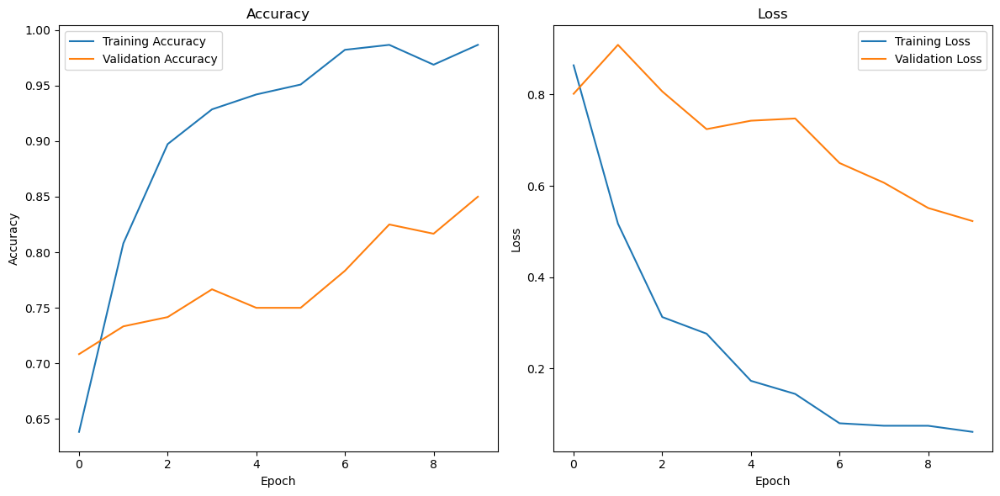

In [23]:
# Grafik plot
# Evaluasi pada test data
loss_fine_inception, test_fine_inception = model_inception.evaluate(test_generator2)
print(f"Test Inception Loss: {loss_fine_inception:.4f}, Test Inception Accuracy: {acc_fine_inception:.4f}")

# Plot grafik akurasi dan loss
plt.figure(figsize=(12, 6))

# Plot Akurasi
plt.subplot(1, 2, 1)
plt.plot(history_fine_inception.history['accuracy'], label='Training Accuracy')
plt.plot(history_fine_inception.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(history_fine_inception.history['loss'], label='Training Loss')
plt.plot(history_fine_inception.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


4/4 [==============================] - 11s 2s/step


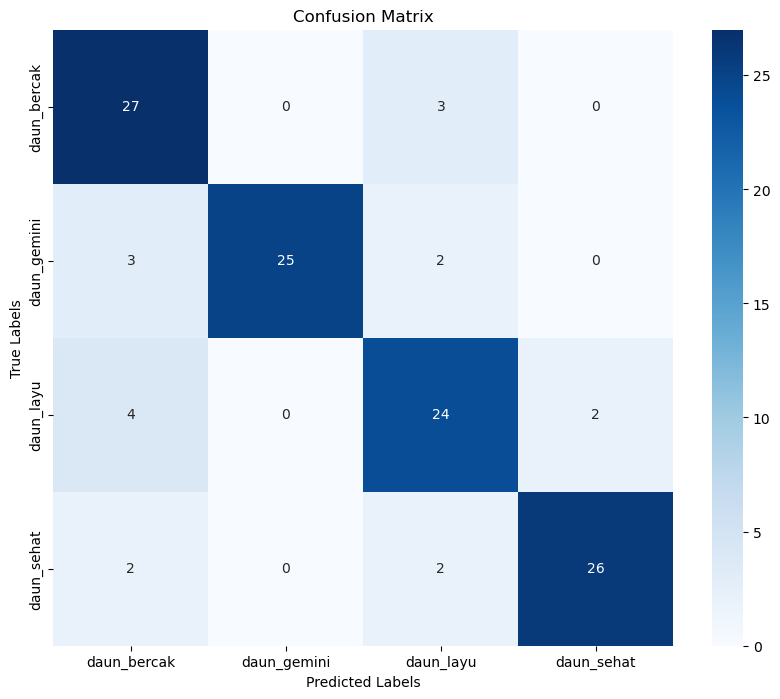

Classification Report:
              precision    recall  f1-score   support

 daun_bercak       0.75      0.90      0.82        30
 daun_gemini       1.00      0.83      0.91        30
   daun_layu       0.77      0.80      0.79        30
  daun_sehat       0.93      0.87      0.90        30

    accuracy                           0.85       120
   macro avg       0.86      0.85      0.85       120
weighted avg       0.86      0.85      0.85       120



In [24]:
# Langkah 1: Prediksi pada Test Data
Y_pred = model_inception.predict(test_generator2)
y_pred_classes = np.argmax(Y_pred, axis=1)  # Konversi prediksi ke label kelas
y_true = test_generator2.classes  # Label sebenarnya

# Langkah 2: Confusion Matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Visualisasi Confusion Matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

# Langkah 3: Classification Report
report = classification_report(y_true, y_pred_classes, target_names=class_names)
print("Classification Report:")
print(report)


1/1 [==============================] - 2s 2s/step


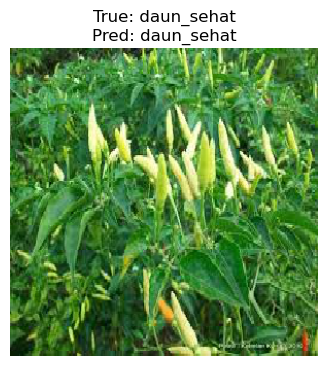

1/1 [==============================] - 0s 140ms/step


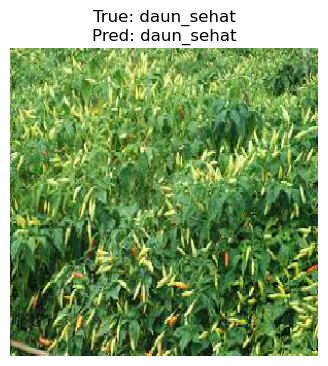

1/1 [==============================] - 0s 109ms/step


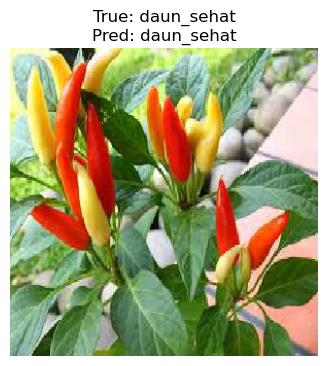

1/1 [==============================] - 0s 115ms/step


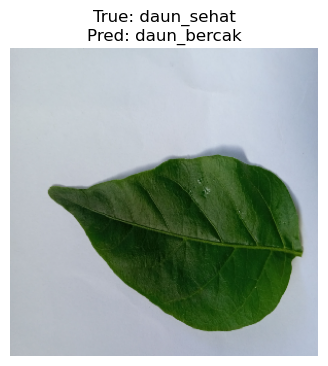

1/1 [==============================] - 0s 113ms/step


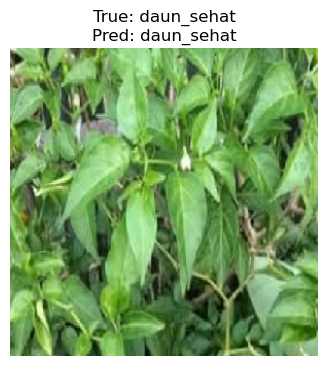

1/1 [==============================] - 0s 113ms/step


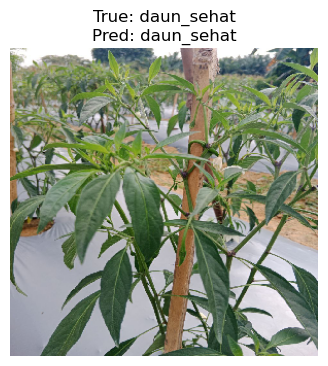

1/1 [==============================] - 0s 110ms/step


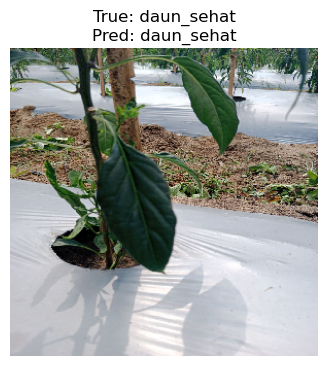

1/1 [==============================] - 0s 108ms/step


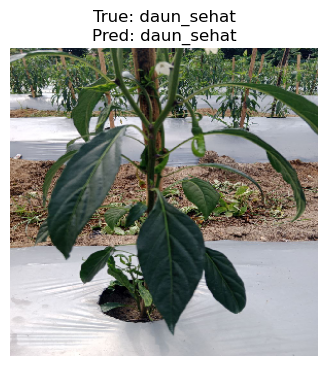

1/1 [==============================] - 0s 126ms/step


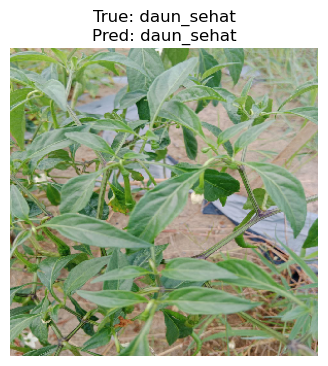

1/1 [==============================] - 0s 108ms/step


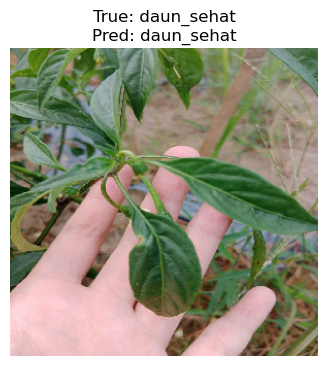

1/1 [==============================] - 0s 110ms/step


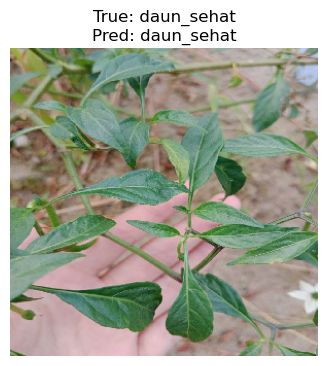

1/1 [==============================] - 0s 99ms/step


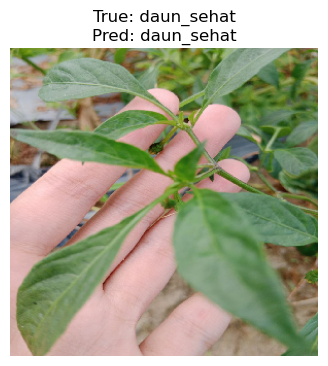

1/1 [==============================] - 0s 100ms/step


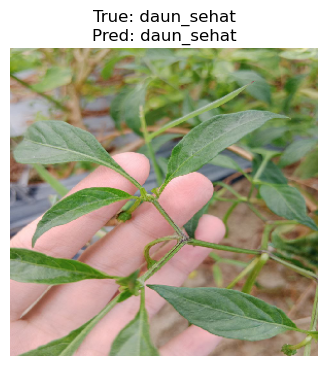

1/1 [==============================] - 0s 102ms/step


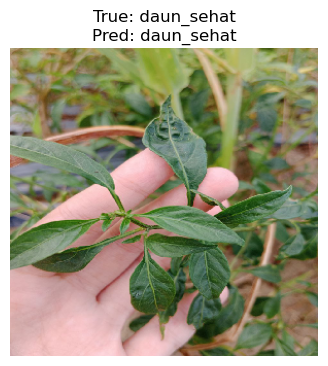

1/1 [==============================] - 0s 117ms/step


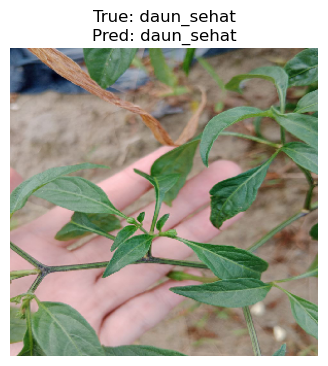

1/1 [==============================] - 0s 110ms/step


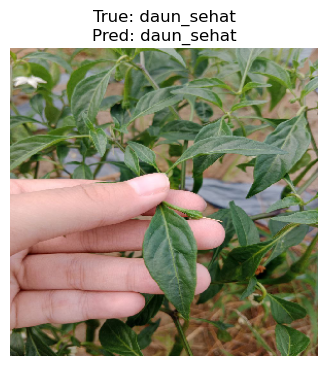

1/1 [==============================] - 0s 106ms/step


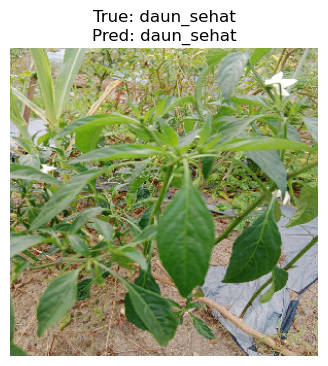

1/1 [==============================] - 0s 110ms/step


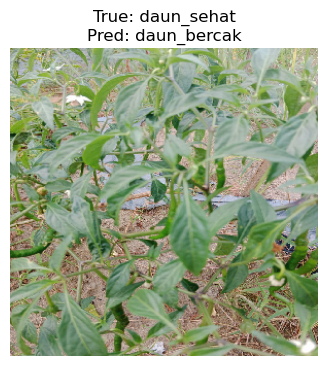

1/1 [==============================] - 0s 101ms/step


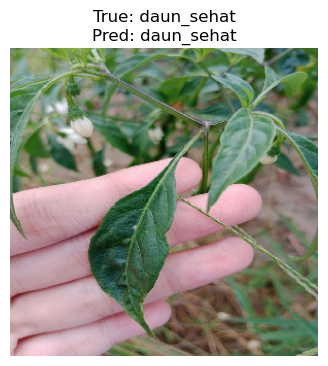

1/1 [==============================] - 0s 117ms/step


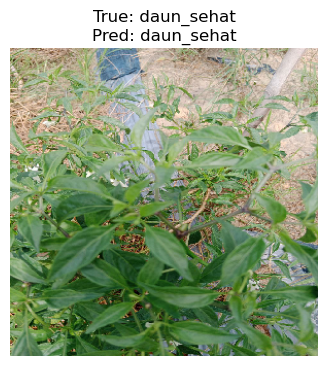

In [28]:
# Validasi prediksi pada 10 gambar pertama dari test_generator
test_images, test_labels = next(test_generator2)

for i in range(20):  # Cek 20 gambar pertama
    img = test_images[i]
    true_class_index = np.argmax(test_labels[i])
    true_class_name = class_names[true_class_index]

    # Prediksi model
    prediction = model_inception.predict(img.reshape(1, 299, 299, 3))
    predicted_class_index = np.argmax(prediction)
    predicted_class_name = class_names[predicted_class_index]

    # Visualisasi
    plt.figure(figsize=(4, 4))
    plt.imshow(img)
    plt.title(f"True: {true_class_name}\nPred: {predicted_class_name}")
    plt.axis('off')
    plt.show()


In [31]:
# Model DenseNet121
# ukuran gambar untuk Dense121
height_densenet = 224
width_densenet = 224
size_densenet = 32  # Ukuran batch

train_generator3 = train_datagen.flow_from_directory(
    directory="D:/KULIAH/asalamualaikum/dataset_split/train",
    color_mode="rgb",
    target_size=(height_densenet, width_densenet),  # Pastikan sesuai dengan kebutuhan model
    class_mode="categorical",
    batch_size=size_densenet,
    shuffle=True,
    seed=42
)

validation_generator3 = val_datagen.flow_from_directory(
    directory="D:/KULIAH/asalamualaikum/dataset_split/validation",
    color_mode="rgb",
    target_size=(height_densenet, width_densenet),  # Pastikan sesuai dengan kebutuhan model
    class_mode="categorical",
    batch_size=size_densenet,
    shuffle=False,
    seed=42
)


test_generator3 = test_datagen.flow_from_directory(
    directory="D:/KULIAH/asalamualaikum/dataset_split/test",
    color_mode="rgb",
    target_size=(height_densenet, width_densenet),  # Pastikan sesuai dengan kebutuhan model
    class_mode="categorical",
    batch_size=size_densenet,
    shuffle=False,
    seed=42
)

# Menampilkan label kelas
class_names = list(train_generator3.class_indices.keys())
print(f"Class labels: {train_generator3.class_indices}")

Found 224 images belonging to 4 classes.
Found 56 images belonging to 4 classes.
Found 120 images belonging to 4 classes.
Class labels: {'daun_bercak': 0, 'daun_gemini': 1, 'daun_layu': 2, 'daun_sehat': 3}


In [34]:
# Load DenseNet121 dengan pre-trained weights di ImageNet
base_model_densenet = DenseNet121(weights="imagenet", include_top=False, input_shape=(height_densenet, width_densenet, 3))
num_classes = len(class_names)

# Freeze layer agar tidak dilatih ulang
base_model_densenet.trainable = False

# Tambahkan lapisan custom
x = base_model_densenet.output
x = GlobalAveragePooling2D()(x)  # Pooling untuk mengurangi dimensi
x = Dense(1024, activation='relu')(x)  # Fully connected layer
x = Dropout(0.5)(x)  # Dropout untuk mencegah overfitting
predictions = Dense(num_classes, activation='softmax')(x)  # Output layer

# Gabungkan model
model_densenet = Model(inputs=base_model_densenet.input, outputs=predictions)

# Kompilasi model
model_densenet.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model_densenet.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_8 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_4 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_8[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_4[0][0]']       
                                )                                                           

In [35]:
# Early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

# Training DenseNet
history_densenet = model_densenet.fit(
    train_generator3,
    validation_data=validation_generator3,
    epochs=30,
    steps_per_epoch=train_generator3.samples // size_densenet,
    validation_steps=validation_generator3.samples // size_densenet,
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)

Epoch 1/30
7/7 [==============================] - 33s 3s/step - loss: 2.0598 - accuracy: 0.3616 - val_loss: 1.0992 - val_accuracy: 0.5625 - lr: 0.0010
Epoch 2/30
7/7 [==============================] - 20s 3s/step - loss: 1.0738 - accuracy: 0.5312 - val_loss: 0.9924 - val_accuracy: 0.5625 - lr: 0.0010
Epoch 3/30
7/7 [==============================] - 19s 3s/step - loss: 0.8742 - accuracy: 0.6473 - val_loss: 0.8235 - val_accuracy: 0.6250 - lr: 0.0010
Epoch 4/30
7/7 [==============================] - 18s 3s/step - loss: 0.7104 - accuracy: 0.7277 - val_loss: 0.8754 - val_accuracy: 0.6562 - lr: 0.0010
Epoch 5/30
7/7 [==============================] - 18s 3s/step - loss: 0.5854 - accuracy: 0.7545 - val_loss: 0.6938 - val_accuracy: 0.7500 - lr: 0.0010
Epoch 6/30
7/7 [==============================] - 18s 3s/step - loss: 0.5368 - accuracy: 0.7723 - val_loss: 0.8544 - val_accuracy: 0.6875 - lr: 0.0010
Epoch 7/30
7/7 [==============================] - 18s 3s/step - loss: 0.4811 - accuracy: 0.812

In [40]:
# Evaluasi pada test set
test_loss_densenet, test_acc_densenet = model_densenet.evaluate(test_generator3)
print(f"Test Accuracy: {test_acc_densenet:.2f}")

4/4 [==============================] - 7s 1s/step - loss: 0.6311 - accuracy: 0.7667
Test Accuracy: 0.77


In [50]:
import tensorflow as tf

# Ubah sebagian layer DenseNet121 menjadi trainable
base_model_densenet.trainable = True

# Pilih layer tertentu untuk di fine-tune
fine_tune_at = 300  # Mulai melatih ulang dari layer ke-300

for layer in base_model_densenet.layers[:fine_tune_at]:
    layer.trainable = False

# Kompilasi ulang model dengan learning rate lebih rendah
model_densenet.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Latih ulang model
history_finetune_densenet = model_densenet.fit(
    train_generator3,
    validation_data=test_generator3,
    epochs=20,  # Tambahkan beberapa epoch untuk fine-tuning
    steps_per_epoch=train_generator3.samples // size_densenet,
    validation_steps=test_generator3.samples // size_densenet,
    verbose=1
)

Epoch 1/20
7/7 [==============================] - 41s 4s/step - loss: 0.1513 - accuracy: 0.9643 - val_loss: 0.7270 - val_accuracy: 0.7917
Epoch 2/20
7/7 [==============================] - 24s 3s/step - loss: 0.0952 - accuracy: 0.9643 - val_loss: 0.6115 - val_accuracy: 0.8750
Epoch 3/20
7/7 [==============================] - 25s 3s/step - loss: 0.0762 - accuracy: 0.9777 - val_loss: 0.5999 - val_accuracy: 0.8750
Epoch 4/20
7/7 [==============================] - 24s 3s/step - loss: 0.0680 - accuracy: 0.9866 - val_loss: 0.5911 - val_accuracy: 0.8646
Epoch 5/20
7/7 [==============================] - 25s 3s/step - loss: 0.0580 - accuracy: 0.9911 - val_loss: 0.6415 - val_accuracy: 0.8646
Epoch 6/20
7/7 [==============================] - 27s 4s/step - loss: 0.0464 - accuracy: 0.9821 - val_loss: 0.6254 - val_accuracy: 0.8854
Epoch 7/20
7/7 [==============================] - 25s 3s/step - loss: 0.0540 - accuracy: 0.9777 - val_loss: 0.5882 - val_accuracy: 0.8750
Epoch 8/20
7/7 [==================

In [51]:
# Evaluasi pada test set
test_loss_densenet, test_acc_densenet = model_densenet.evaluate(test_generator3)
print(f"Test Accuracy: {test_acc_densenet:.2f}")

4/4 [==============================] - 7s 1s/step - loss: 0.6012 - accuracy: 0.9083
Test Accuracy: 0.91


In [53]:
model_densenet.save("model_densenet.h5")
print("Model berhasil disimpan")

Model berhasil disimpan


4/4 [==============================] - 8s 2s/step - loss: 0.6012 - accuracy: 0.9083
Test Inception Loss: 0.6012, Test Inception Accuracy: 0.9083


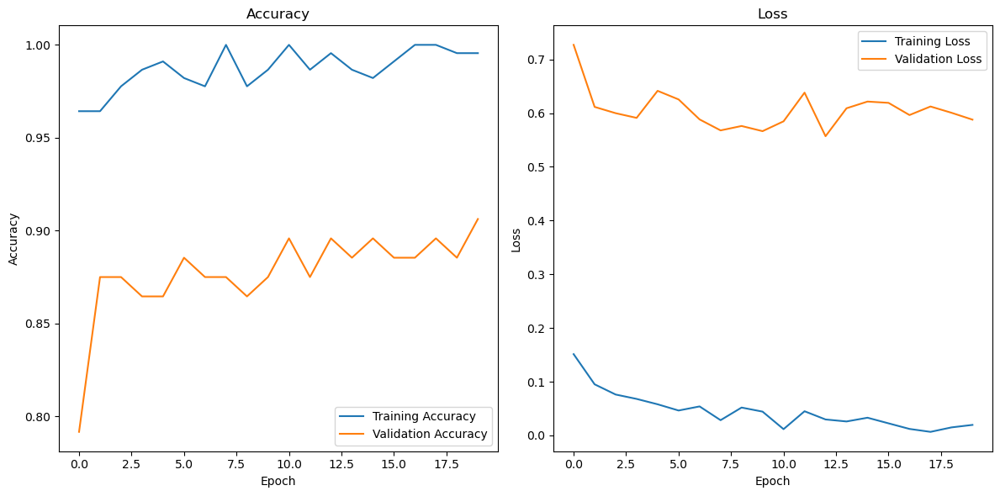

In [54]:
# Grafik plot
# Evaluasi pada test data
test_loss_densenet, test_acc_densenet = model_densenet.evaluate(test_generator3)
print(f"Test Inception Loss: {test_loss_densenet:.4f}, Test Inception Accuracy: {test_acc_densenet:.4f}")

# Plot grafik akurasi dan loss
plt.figure(figsize=(12, 6))

# Plot Akurasi
plt.subplot(1, 2, 1)
plt.plot(history_finetune_densenet.history['accuracy'], label='Training Accuracy')
plt.plot(history_finetune_densenet.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(history_finetune_densenet.history['loss'], label='Training Loss')
plt.plot(history_finetune_densenet.history['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


4/4 [==============================] - 10s 1s/step


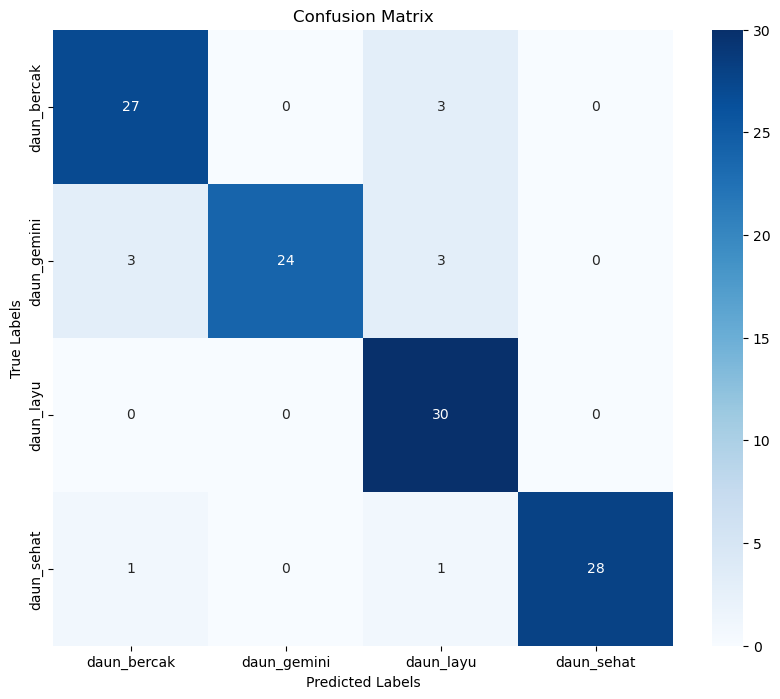

Classification Report:
              precision    recall  f1-score   support

 daun_bercak       0.87      0.90      0.89        30
 daun_gemini       1.00      0.80      0.89        30
   daun_layu       0.81      1.00      0.90        30
  daun_sehat       1.00      0.93      0.97        30

    accuracy                           0.91       120
   macro avg       0.92      0.91      0.91       120
weighted avg       0.92      0.91      0.91       120



In [55]:
# Langkah 1: Prediksi pada Test Data
Y_pred = model_densenet.predict(test_generator3)
y_pred_classes = np.argmax(Y_pred, axis=1)  # Konversi prediksi ke label kelas
y_true = test_generator3.classes  # Label sebenarnya

# Langkah 2: Confusion Matrix
cm = confusion_matrix(y_true, y_pred_classes)

# Visualisasi Confusion Matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

# Langkah 3: Classification Report
report = classification_report(y_true, y_pred_classes, target_names=class_names)
print("Classification Report:")
print(report)


1/1 [==============================] - 3s 3s/step


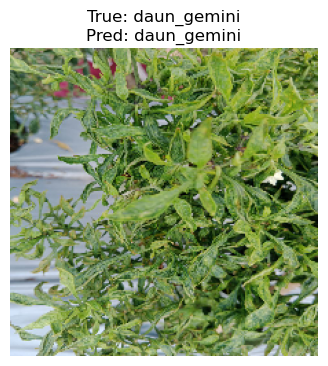

1/1 [==============================] - 0s 76ms/step


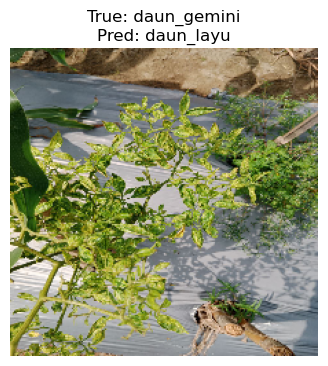

1/1 [==============================] - 0s 155ms/step


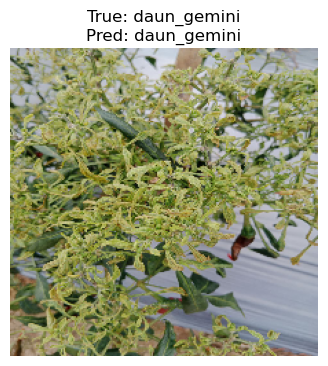

1/1 [==============================] - 0s 68ms/step


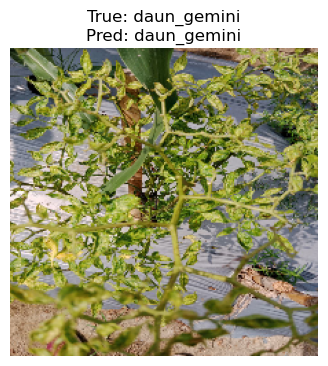

1/1 [==============================] - 0s 100ms/step


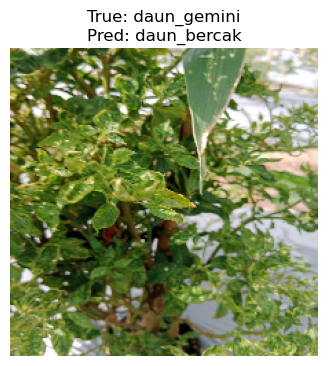

1/1 [==============================] - 0s 66ms/step


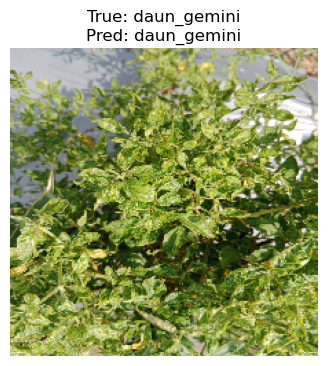

1/1 [==============================] - 0s 70ms/step


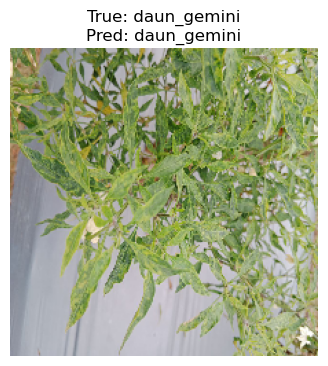

1/1 [==============================] - 0s 79ms/step


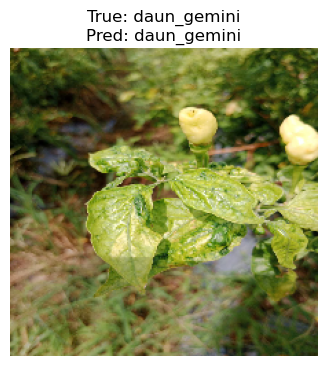

1/1 [==============================] - 0s 65ms/step


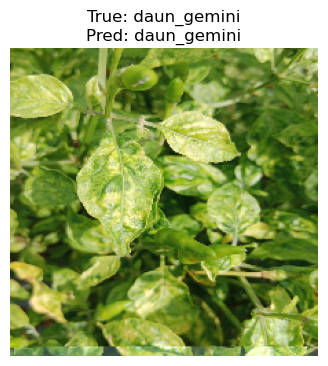

1/1 [==============================] - 0s 69ms/step


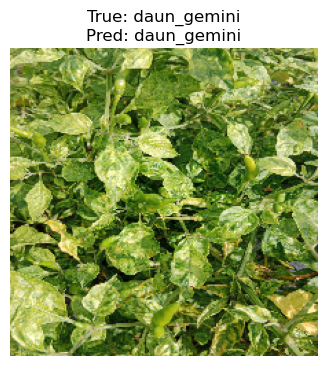

1/1 [==============================] - 0s 63ms/step


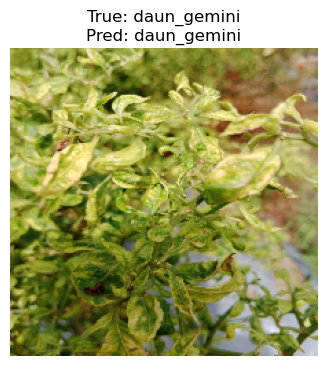

1/1 [==============================] - 0s 95ms/step


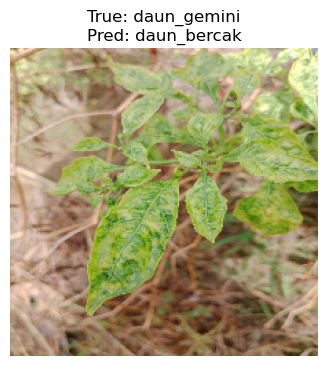

1/1 [==============================] - 0s 58ms/step


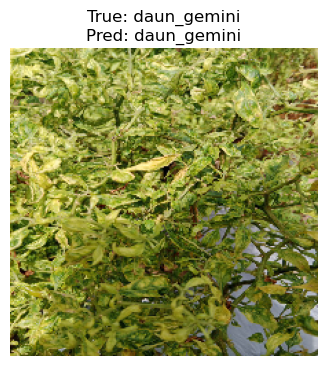

1/1 [==============================] - 0s 74ms/step


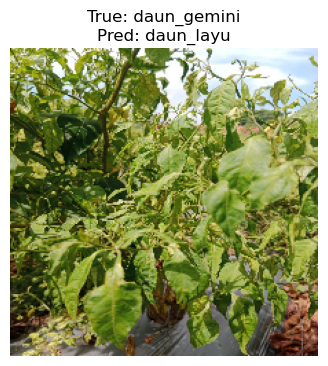

1/1 [==============================] - 0s 103ms/step


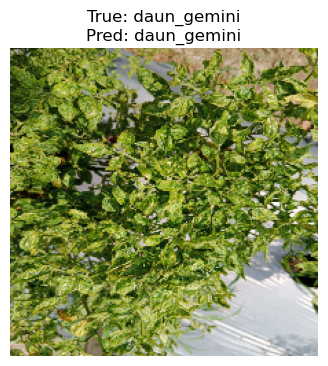

1/1 [==============================] - 0s 74ms/step


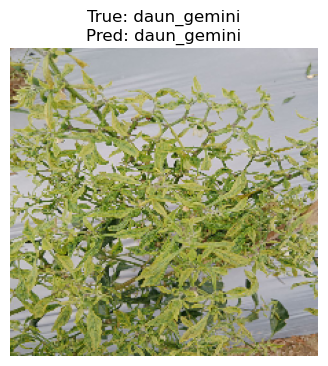

1/1 [==============================] - 0s 79ms/step


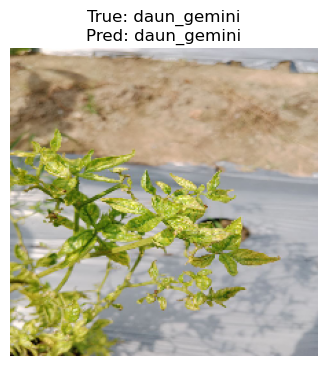

1/1 [==============================] - 0s 77ms/step


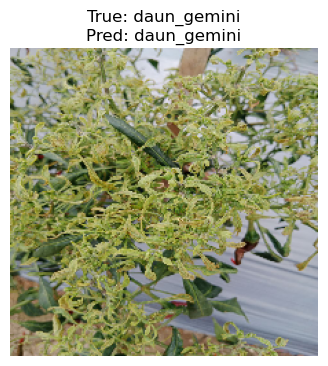

1/1 [==============================] - 0s 80ms/step


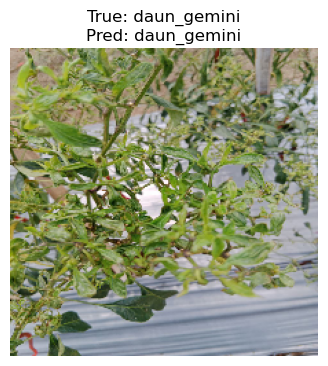

1/1 [==============================] - 0s 73ms/step


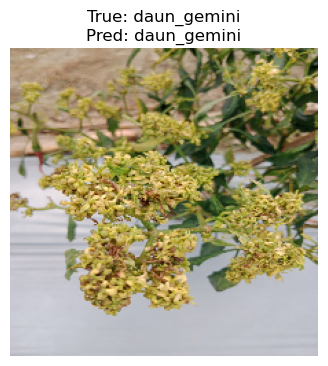

In [57]:
# Validasi prediksi pada 10 gambar pertama dari test_generator
test_images, test_labels = next(test_generator3)

for i in range(20):  # Cek 20 gambar pertama
    img = test_images[i]
    true_class_index = np.argmax(test_labels[i])
    true_class_name = class_names[true_class_index]

    # Prediksi model
    prediction = model_densenet.predict(img.reshape(1, 224, 224, 3))
    predicted_class_index = np.argmax(prediction)
    predicted_class_name = class_names[predicted_class_index]

    # Visualisasi
    plt.figure(figsize=(4, 4))
    plt.imshow(img)
    plt.title(f"True: {true_class_name}\nPred: {predicted_class_name}")
    plt.axis('off')
    plt.show()


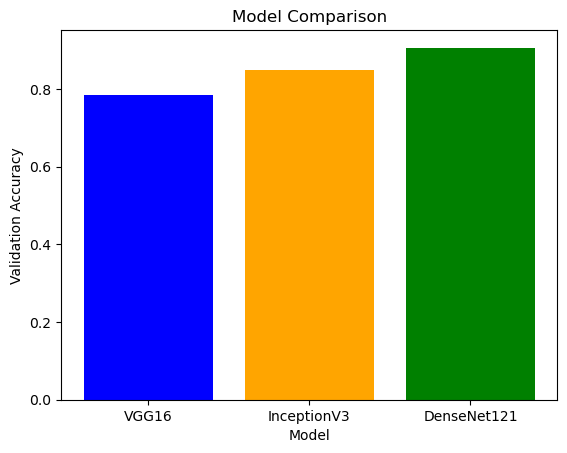

In [112]:
# 6. Model Comparison
model_names = ["VGG16", "InceptionV3", "DenseNet121"]
accuracies = [history_finevgg16.history['val_accuracy'][-1],
              history_fine_inception.history['val_accuracy'][-1], 
              history_finetune_densenet.history['val_accuracy'][-1]]

plt.bar(model_names, accuracies, color=['blue','orange', 'green'])
plt.title("Model Comparison")
plt.ylabel("Validation Accuracy")
plt.xlabel("Model")
plt.show()

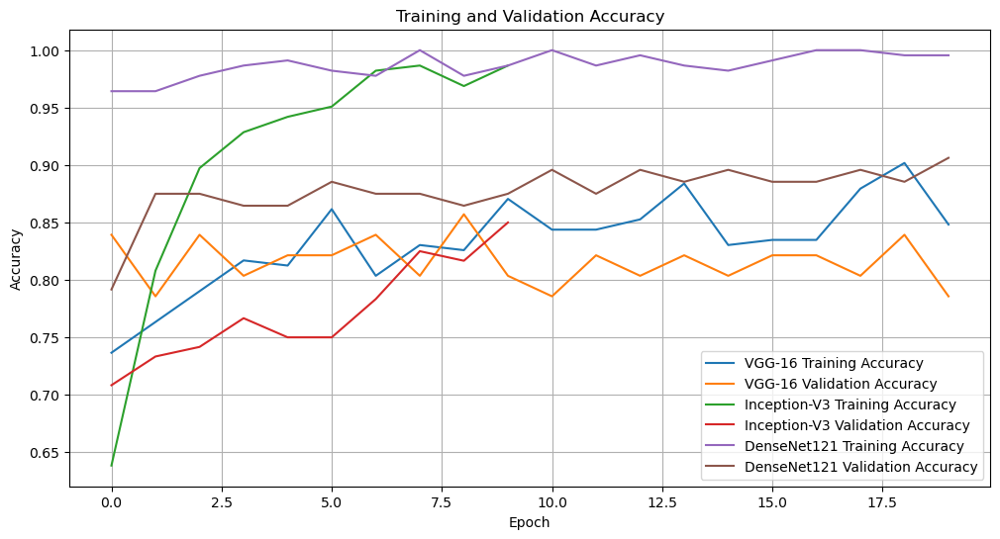

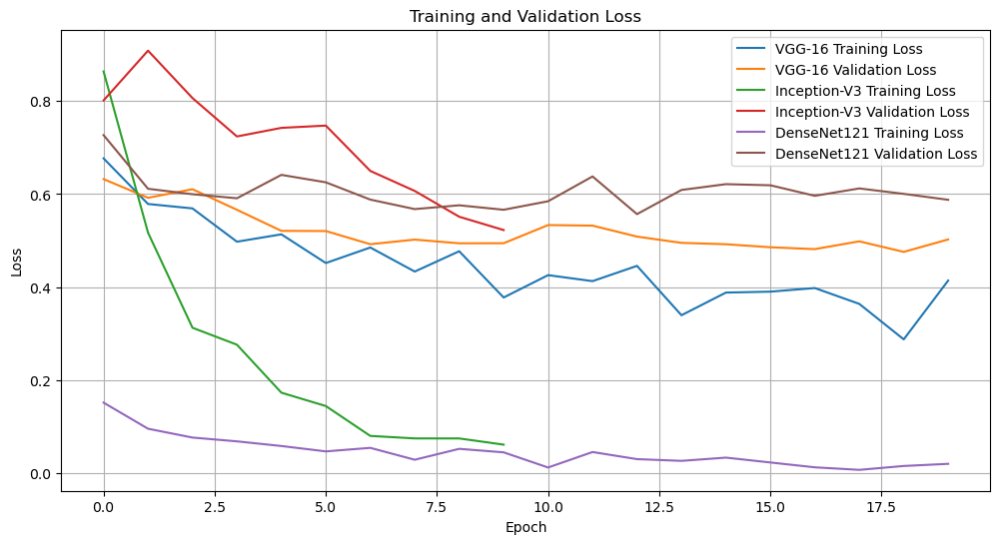

In [110]:
# Perbandingan 3 model

# Ambil data dari history
history_vgg = history_finevgg16.history  # History dari model VGG-16
history_inception = history_fine_inception.history  # History dari model Inception-V3
history_densenet = history_finetune_densenet.history  # History dari model DenseNet121

# Plot akurasi
plt.figure(figsize=(12, 6))
plt.plot(history_vgg['accuracy'], label='VGG-16 Training Accuracy')
plt.plot(history_vgg['val_accuracy'], label='VGG-16 Validation Accuracy')
plt.plot(history_inception['accuracy'], label='Inception-V3 Training Accuracy')
plt.plot(history_inception['val_accuracy'], label='Inception-V3 Validation Accuracy')
plt.plot(history_densenet['accuracy'], label='DenseNet121 Training Accuracy')
plt.plot(history_densenet['val_accuracy'], label='DenseNet121 Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

# Plot loss
plt.figure(figsize=(12, 6))
plt.plot(history_vgg['loss'], label='VGG-16 Training Loss')
plt.plot(history_vgg['val_loss'], label='VGG-16 Validation Loss')
plt.plot(history_inception['loss'], label='Inception-V3 Training Loss')
plt.plot(history_inception['val_loss'], label='Inception-V3 Validation Loss')
plt.plot(history_densenet['loss'], label='DenseNet121 Training Loss')
plt.plot(history_densenet['val_loss'], label='DenseNet121 Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()


In [113]:
# Cari nilai terbaik untuk masing-masing model
best_vgg_accuracy = max(history_vgg['val_accuracy'])
best_vgg_loss = min(history_vgg['val_loss'])

best_inception_accuracy = max(history_inception['val_accuracy'])
best_inception_loss = min(history_inception['val_loss'])

best_densenet_accuracy = max(history_densenet['val_accuracy'])
best_densenet_loss = min(history_densenet['val_loss'])

# Tampilkan hasil
print("Model Comparison:")
print(f"VGG-16 -> Best Val Accuracy: {best_vgg_accuracy:.4f}, Best Val Loss: {best_vgg_loss:.4f}")
print(f"Inception-V3 -> Best Val Accuracy: {best_inception_accuracy:.4f}, Best Val Loss: {best_inception_loss:.4f}")
print(f"DenseNet121 -> Best Val Accuracy: {best_densenet_accuracy:.4f}, Best Val Loss: {best_densenet_loss:.4f}")


Model Comparison:
VGG-16 -> Best Val Accuracy: 0.8571, Best Val Loss: 0.4757
Inception-V3 -> Best Val Accuracy: 0.8500, Best Val Loss: 0.5227
DenseNet121 -> Best Val Accuracy: 0.9062, Best Val Loss: 0.5570


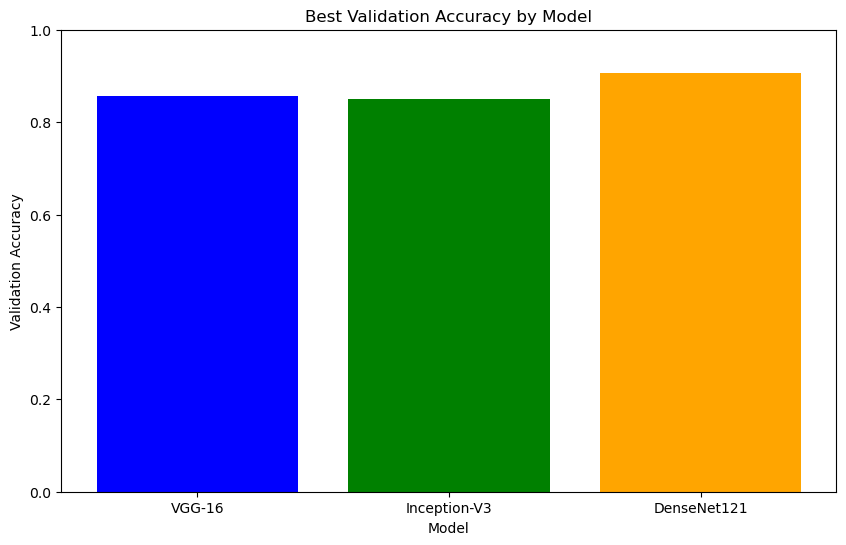

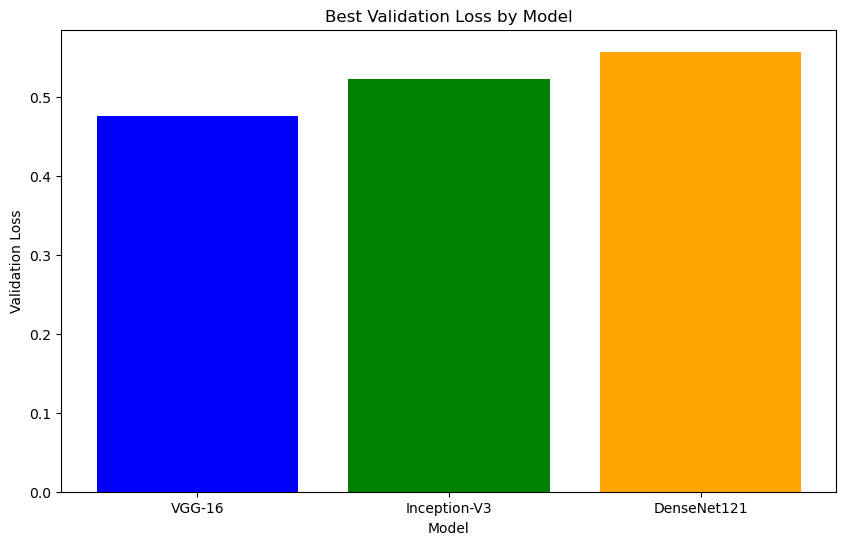

In [114]:
import matplotlib.pyplot as plt

# Data untuk setiap model
models = ['VGG-16', 'Inception-V3', 'DenseNet121']
accuracies = [best_vgg_accuracy, best_inception_accuracy, best_densenet_accuracy]
losses = [best_vgg_loss, best_inception_loss, best_densenet_loss]

# Plot Akurasi
plt.figure(figsize=(10, 6))
plt.bar(models, accuracies, color=['blue', 'green', 'orange'])
plt.title('Best Validation Accuracy by Model')
plt.xlabel('Model')
plt.ylabel('Validation Accuracy')
plt.ylim(0, 1)  # Akurasi berada dalam rentang [0, 1]
plt.show()

# Plot Loss
plt.figure(figsize=(10, 6))
plt.bar(models, losses, color=['blue', 'green', 'orange'])
plt.title('Best Validation Loss by Model')
plt.xlabel('Model')
plt.ylabel('Validation Loss')
plt.show()


In [115]:
import pandas as pd

# Simpan hasil dalam bentuk dictionary
results = {
    "Model": ["VGG-16", "Inception-V3", "DenseNet121"],
    "Best Validation Accuracy": [best_vgg_accuracy, best_inception_accuracy, best_densenet_accuracy],
    "Best Validation Loss": [best_vgg_loss, best_inception_loss, best_densenet_loss]
}

# Convert ke DataFrame untuk tampilan tabel
results_df = pd.DataFrame(results)

# Cetak hasil
print(results_df)


          Model  Best Validation Accuracy  Best Validation Loss
0        VGG-16                  0.857143              0.475720
1  Inception-V3                  0.850000              0.522732
2   DenseNet121                  0.906250              0.556975
